In [128]:
from pyspark.sql.functions import pandas_udf, PandasUDFType
from pyspark.sql.types import StructType,StructField,StringType,LongType,DoubleType,FloatType,DateType

In [130]:
import statsmodels.tsa.api as sm
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from sklearn.ensemble import IsolationForest
from prophet import Prophet

In [132]:
SPARK_LOCAL_IP = "127.0.1.1"

In [134]:
import pyspark
from pyspark.sql import SparkSession
spark = SparkSession.builder.appName('Climate').getOrCreate()

03-22 11:21:22.079 192.168.86.147:54321  8801     Thread-5  WARN org.apache.spark.sql.SparkSession: Using an existing Spark session; only runtime SQL configurations will take effect.


In [136]:
df = pd.read_csv("Hist-month.csv")
df.head()

,cities,time,lat,lon,tasmax,tasmin,pr
0,Tokyo,1950-01-01,35.625,139.625,281.38812,275.24900,151.38026
1,Tokyo,1950-02-01,35.625,139.625,281.84033,273.90646,64.06377
2,Tokyo,1950-03-01,35.625,139.625,283.07350,275.41818,54.90432
3,Tokyo,1950-04-01,35.625,139.625,289.07657,281.53793,138.73988
4,Tokyo,1950-05-01,35.625,139.625,293.34790,286.44050,188.84598


In [138]:
df.shape

(83460, 7)

In [140]:
df['time'] = pd.to_datetime(df['time'])

In [142]:
df['year'] = pd.DatetimeIndex(df['time']).year
df.head()

,cities,time,lat,lon,tasmax,tasmin,pr,year
0,Tokyo,1950-01-01,35.625,139.625,281.38812,275.24900,151.38026,1950
1,Tokyo,1950-02-01,35.625,139.625,281.84033,273.90646,64.06377,1950
2,Tokyo,1950-03-01,35.625,139.625,283.07350,275.41818,54.90432,1950
3,Tokyo,1950-04-01,35.625,139.625,289.07657,281.53793,138.73988,1950
4,Tokyo,1950-05-01,35.625,139.625,293.34790,286.44050,188.84598,1950


In [144]:
s_df =df.set_index('time')

<AxesSubplot: xlabel='time'>

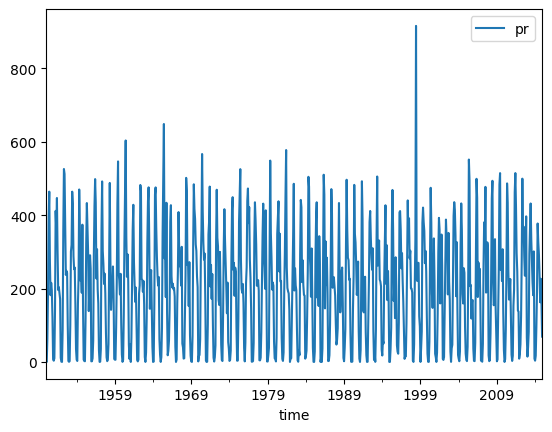

In [146]:
s_df.query('cities==\"Douala\"')[['pr']].plot()

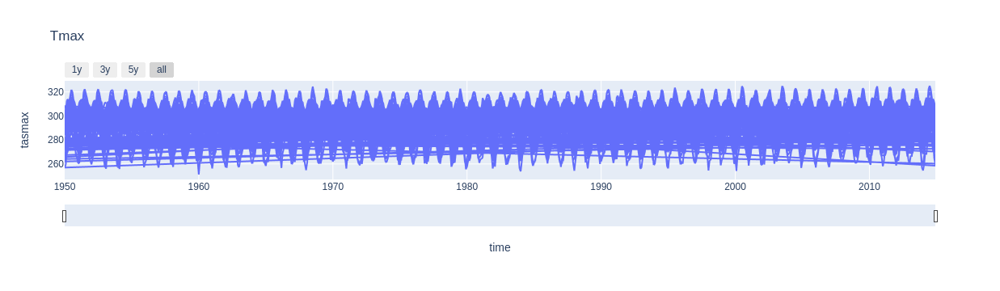

In [148]:
fig = px.line(df.reset_index(), x='time', y='tasmax', title='Tmax')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=2, label="3y", step="year", stepmode="backward"),
            dict(count=3, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

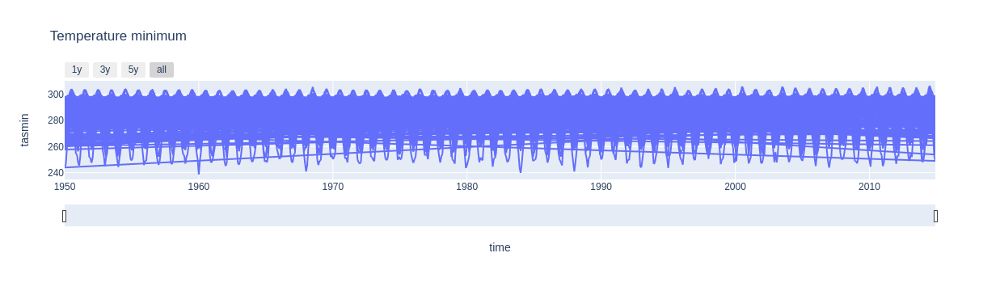

In [149]:
fig = px.line(df.reset_index(), x='time', y='tasmin', title='Temperature minimum')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=2, label="3y", step="year", stepmode="backward"),
            dict(count=3, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

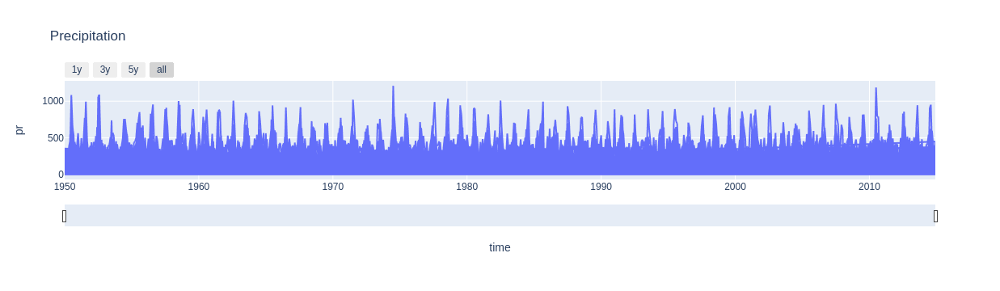

In [150]:
fig = px.line(df.reset_index(), x='time', y='pr', title='Precipitation')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=2, label="3y", step="year", stepmode="backward"),
            dict(count=3, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

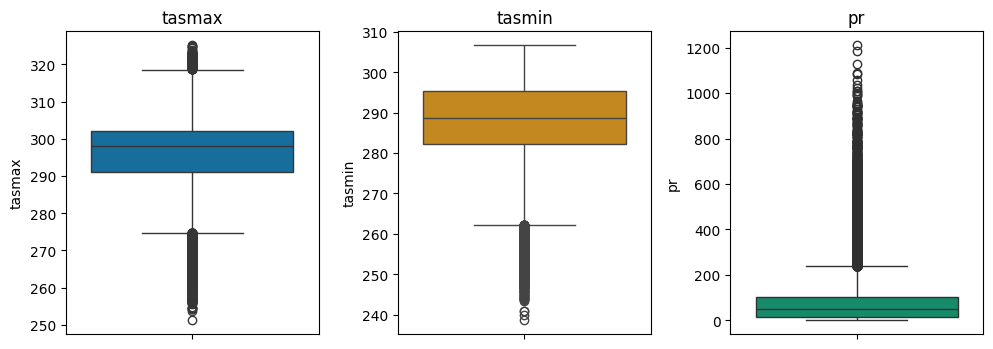

In [154]:
palette = sns.color_palette("colorblind")
cols=['tasmax','tasmin','pr']
df_cols=df[cols]
plt.figure(figsize=(20,10))

# Loop through each column (excluding 'Year')
for i, column in enumerate(df_cols):
    # Create a subplot for each column
    plt.subplot(3, 6, i+1)
    # Use modulo to cycle through the colorblind-friendly palette
    color = palette[i % len(palette)]
    sns.boxplot(y=df[column], color=color)
    plt.title(column)
    plt.tight_layout()

plt.show()

In [156]:
from scipy.stats import shapiro

varis=['tasmax','tasmin','pr']
for vari in varis:
    stat, p = shapiro(df[vari])
    print(f'{vari}: Statistics={stat}, p={p}')
    if p > 0.05:
        print('Sample looks Gaussian (fail to reject H0)')
    else:
        print('Sample does not look Gaussian (reject H0)')

tasmax: Statistics=0.9526652502633991, p=3.47056835587466e-89
Sample does not look Gaussian (reject H0)
tasmin: Statistics=0.9435282272825881, p=1.5619172346715224e-93
Sample does not look Gaussian (reject H0)
pr: Statistics=0.7357943109847196, p=5.0085303015736654e-136
Sample does not look Gaussian (reject H0)


/tmp/ipykernel_5796/2802764880.py:5: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 83460.



***Anomaly Detection using Isolation Forest*** 

In [159]:
model =  IsolationForest(contamination=0.004)
model.fit(df[['pr']]) 

IsolationForest(contamination=0.004)

In [160]:
df['outliers']=pd.Series(model.predict(df[['pr']])).apply(lambda x: 'yes' if (x == -1) else 'no' )

In [162]:
df.query('outliers=="yes"')

,cities,time,lat,lon,tasmax,tasmin,pr,year,outliers
2347,Manila,1950-08-01,14.625,120.875,303.07623,299.02830,642.42640,1950,yes
2359,Manila,1951-08-01,14.625,120.875,301.56238,298.73892,993.86066,1951,yes
2394,Manila,1954-07-01,14.625,120.875,302.55536,298.95914,758.82950,1954,yes
2395,Manila,1954-08-01,14.625,120.875,301.43976,298.61703,612.19230,1954,yes
2406,Manila,1955-07-01,14.625,120.875,303.35046,299.15372,616.94050,1955,yes
...,...,...,...,...,...,...,...,...,...
63152,Conakry,2012-09-01,9.625,-13.625,300.99220,297.93045,634.27905,2012,yes
63162,Conakry,2013-07-01,9.625,-13.625,300.72880,297.88025,655.23150,2013,yes
63163,Conakry,2013-08-01,9.625,-13.625,300.18454,297.69260,944.90784,2013,yes
63174,Conakry,2014-07-01,9.625,-13.625,300.28150,297.67510,906.69950,2014,yes


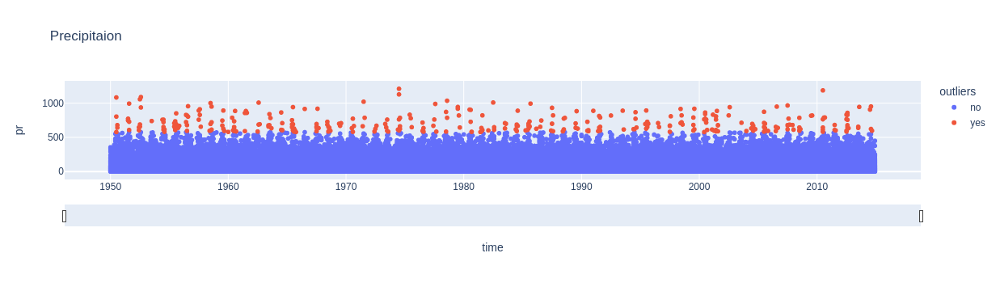

In [165]:
fig = px.scatter(df.reset_index(), x='time', y='pr', color='outliers', title='Precipitaion')

fig.update_xaxes(
    rangeslider_visible=True,
)
fig.show()

**Trend Analysis**

In [168]:
df_new = df[df['cities']=="Conakry"]

In [170]:
df_new.head()

,cities,time,lat,lon,tasmax,tasmin,pr,year,outliers
62400,Conakry,1950-01-01,9.625,-13.625,300.17694,295.55893,0.000000,1950,no
62401,Conakry,1950-02-01,9.625,-13.625,300.64822,295.94230,0.000000,1950,no
62402,Conakry,1950-03-01,9.625,-13.625,302.05392,297.07250,0.000000,1950,no
62403,Conakry,1950-04-01,9.625,-13.625,302.85178,297.62906,0.000000,1950,no
62404,Conakry,1950-05-01,9.625,-13.625,302.46744,297.76740,6.438404,1950,no



Trend Analysis for tasmax:
Slope: 0.01019188388694637
Intercept: 281.1343907129954


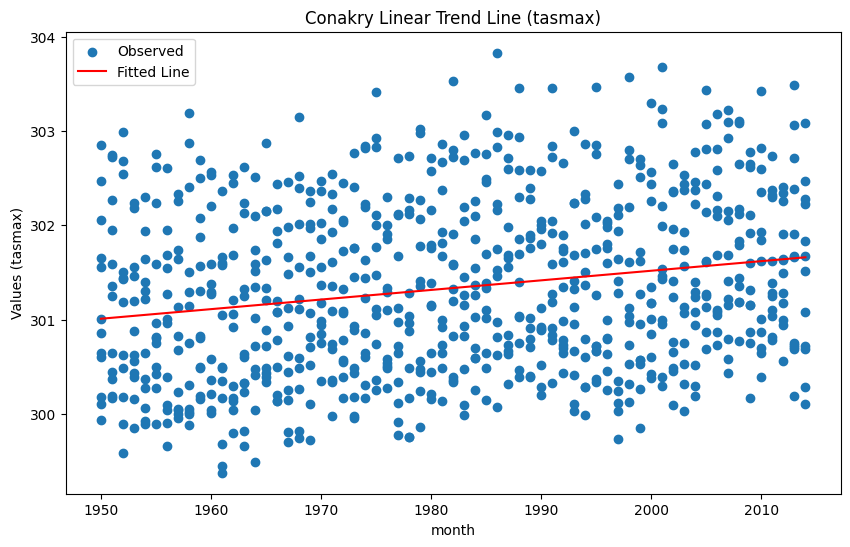


Trend Analysis for tasmin:
Slope: 0.009170739000582752
Intercept: 279.14396874956293


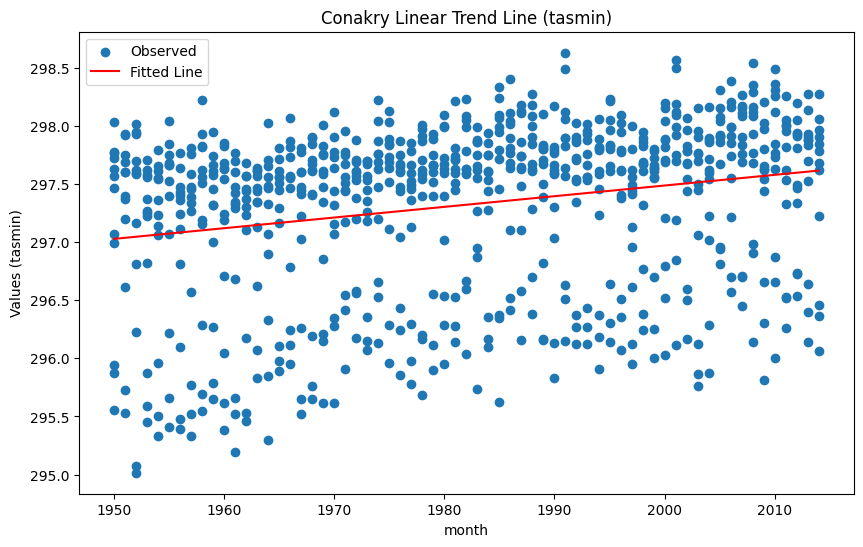


Trend Analysis for pr:
Slope: -0.06433873175258356
Intercept: 348.5942782018304


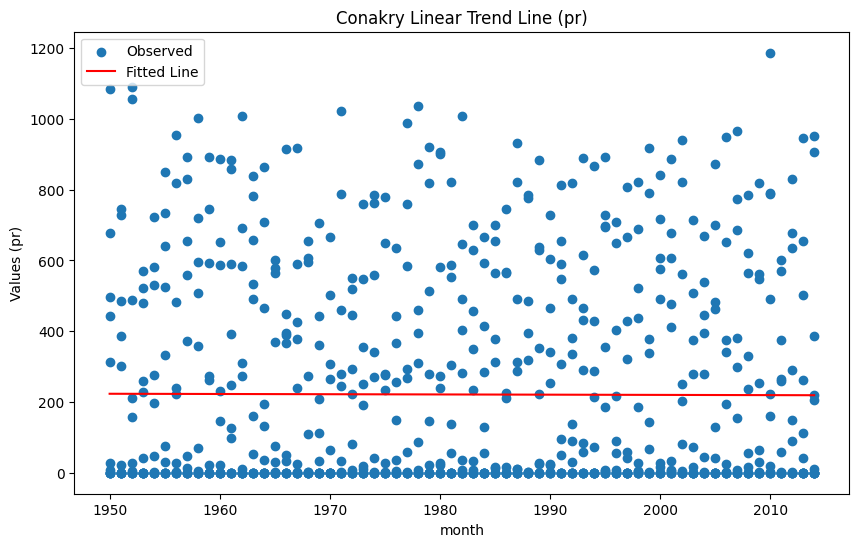

In [172]:
from sklearn.linear_model import LinearRegression

X = df_new['year'].values.reshape(-1, 1)
varis = ['tasmax', 'tasmin', 'pr']

for vari in varis:
    y = df_new[vari]

    model = LinearRegression().fit(X, y)
    print(f"\nTrend Analysis for {vari}:")
    print(f"Slope: {model.coef_[0]}")
    print(f"Intercept: {model.intercept_}")

    y_pred = model.predict(X)

    plt.figure(figsize=(10, 6))
    plt.scatter(df_new['year'], y, label='Observed')
    plt.plot(df_new['year'], y_pred, color='red', label='Fitted Line')
    plt.xlabel('month')
    plt.ylabel(f'Values ({vari})')
    plt.title(f'Conakry Linear Trend Line ({vari})')
    plt.legend()
    plt.show()


**Statistical Analysis**

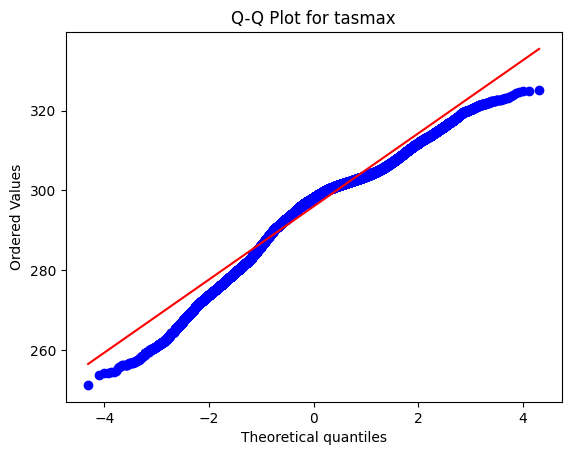

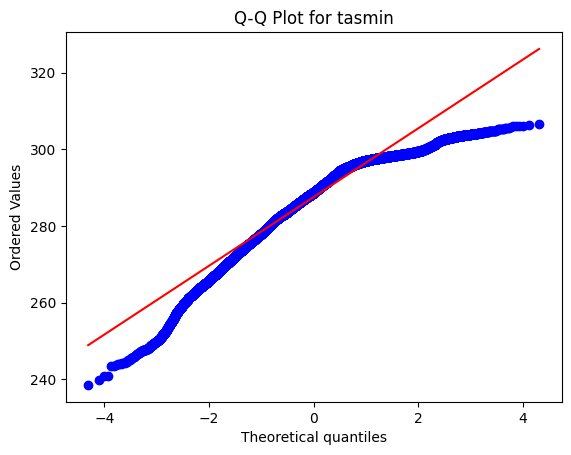

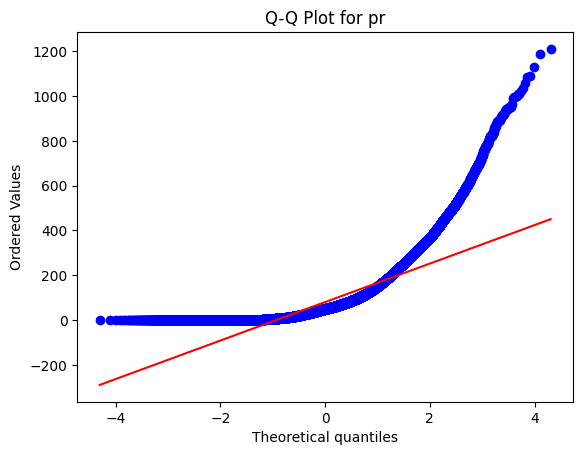

In [175]:
import scipy.stats as stats
import matplotlib.pyplot as plt

varis = ['tasmax', 'tasmin', 'pr']

for vari in varis:
    plt.figure()
    stats.probplot(df[vari], dist="norm", plot=plt)
    plt.title(f'Q-Q Plot for {vari}')
    plt.show()

/tmp/ipykernel_5796/2681221066.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



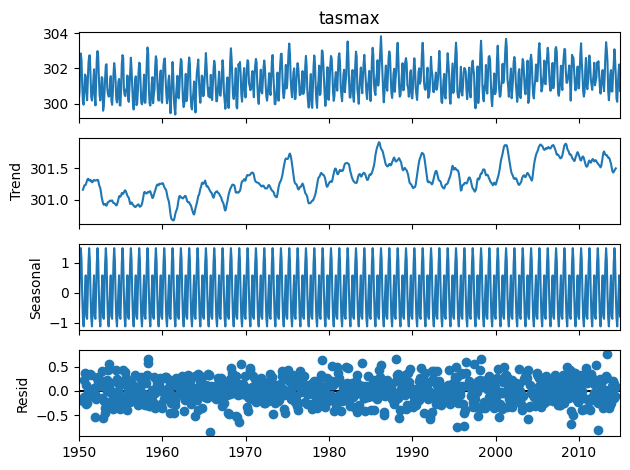

In [177]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Convert year to datetime format to prepare for seasonal_decompose
df_new['time'] = pd.to_datetime(df_new['time'], format='%Y-%m-%d')
df_new.set_index('time', inplace=True)

result = seasonal_decompose(df_new['tasmax'], model='additive')

result.plot()
plt.show()

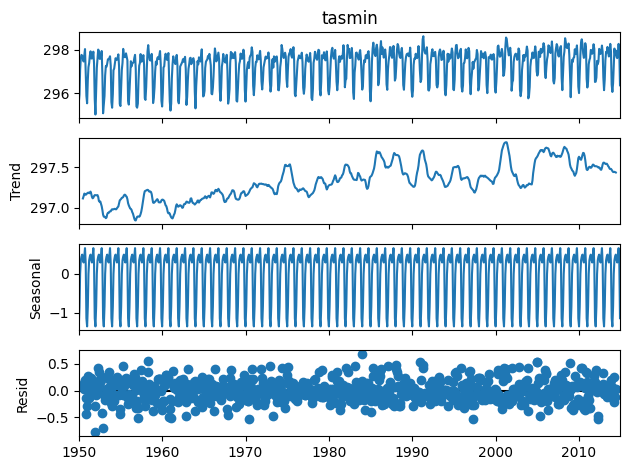

In [179]:
result = seasonal_decompose(df_new['tasmin'], model='additive')

result.plot()
plt.show()

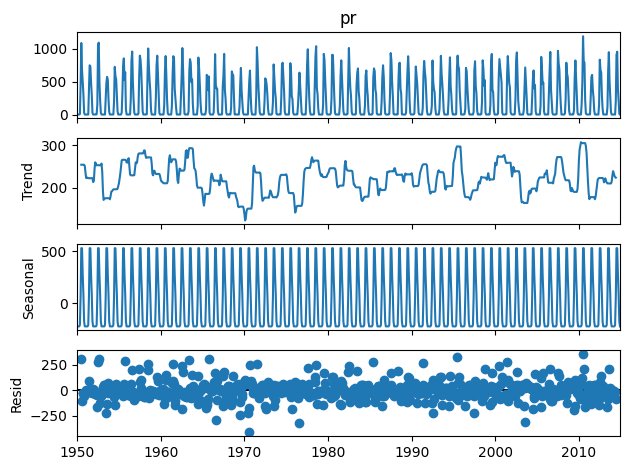

In [181]:
result = seasonal_decompose(df_new['pr'], model='additive')

result.plot()
plt.show()

In [183]:
import pymannkendall as mk

result = mk.original_test(df_new['tasmax'])

print(f"Trend: {result.trend}")
print(f"P-value: {result.p}")
print(f"Z-value: {result.z}")
print(f"Slope (Sen's slope): {result.slope}")

Trend: increasing
P-value: 1.409344529967882e-08
Z-value: 5.672249573513367
Slope (Sen's slope): 0.0008554838921666042


**Change point

In [186]:
# from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# plot_acf(ts)
# plot_pacf(ts)
# plt.show()

In [188]:
train = df[(df['time'] >= '2000-01-01') & (df['time'] <= '2013-12-31')]
test = df[(df['time'] > '2013-12-31')]

In [190]:
train.head()

,cities,time,lat,lon,tasmax,tasmin,pr,year,outliers
600,Tokyo,2000-01-01,35.625,139.625,282.36273,275.62878,140.338150,2000,no
601,Tokyo,2000-02-01,35.625,139.625,281.90350,274.93628,100.743730,2000,no
602,Tokyo,2000-03-01,35.625,139.625,285.69016,277.73608,57.941525,2000,no
603,Tokyo,2000-04-01,35.625,139.625,289.66595,282.33713,56.267430,2000,no
604,Tokyo,2000-05-01,35.625,139.625,294.04276,286.97202,45.699436,2000,no


In [192]:
train=train.drop(["lat","lon","outliers","year"],axis=1)
# #train = train.reset_index

In [194]:
colschema = StructType([StructField("cities", StringType(), True),
                        StructField("time", DateType(), True),
                        StructField("tasmax", DoubleType(), True),
                        StructField("tasmin", DoubleType(), True),
                        StructField("pr", DoubleType(), True),
                    ])

In [196]:
sdf = spark.createDataFrame(train,schema=colschema)
sdf.printSchema()

root
 |-- cities: string (nullable = true)
 |-- time: date (nullable = true)
 |-- tasmax: double (nullable = true)
 |-- tasmin: double (nullable = true)
 |-- pr: double (nullable = true)



In [198]:
sdf.count()

03-22 11:22:16.083 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Registering RDD 58 (count at NativeMethodAccessorImpl.java:0) as input to shuffle 5
03-22 11:22:16.084 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Got map stage job 11 (count at NativeMethodAccessorImpl.java:0) with 8 output partitions
03-22 11:22:16.084 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Final stage: ShuffleMapStage 18 (count at NativeMethodAccessorImpl.java:0)
03-22 11:22:16.084 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Parents of final stage: List()
03-22 11:22:16.084 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Missing parents: List()
03-22 11:22:16.085 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Submitting ShuffleMapStage 18 (MapPartitionsRDD[58] at count 

17976

In [200]:
sdf.select(['cities']).groupBy('cities').agg({'cities':'count'}).show()

03-22 11:22:16.565 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Registering RDD 63 (showString at NativeMethodAccessorImpl.java:0) as input to shuffle 6
03-22 11:22:16.566 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Got map stage job 13 (showString at NativeMethodAccessorImpl.java:0) with 8 output partitions
03-22 11:22:16.566 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Final stage: ShuffleMapStage 21 (showString at NativeMethodAccessorImpl.java:0)
03-22 11:22:16.566 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Parents of final stage: List()
03-22 11:22:16.566 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Missing parents: List()
03-22 11:22:16.566 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Submitting ShuffleMapStage 21 (MapPartitionsRD

In [202]:
sdf.createOrReplaceTempView("pred")

In [204]:
sql = 'SELECT cities, time as ds, sum(tasmax) as y FROM pred GROUP BY cities, ds ORDER BY cities, ds'

In [206]:
spark.sql(sql).show()

03-22 11:22:18.520 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Registering RDD 68 (showString at NativeMethodAccessorImpl.java:0) as input to shuffle 7
03-22 11:22:18.521 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Got map stage job 15 (showString at NativeMethodAccessorImpl.java:0) with 8 output partitions
03-22 11:22:18.521 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Final stage: ShuffleMapStage 24 (showString at NativeMethodAccessorImpl.java:0)
03-22 11:22:18.521 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Parents of final stage: List()
03-22 11:22:18.521 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Missing parents: List()
03-22 11:22:18.521 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Submitting ShuffleMapStage 24 (MapPartitionsRD

In [208]:
df_part = (spark.sql( sql ).repartition(spark.sparkContext.defaultParallelism, ['cities'])).cache()

In [210]:
df_part

DataFrame[cities: string, ds: date, y: double]

In [212]:
from pyspark.sql.types import *

result_schema =StructType([
  StructField('ds',DateType()),
  StructField('cities',StringType()),
  StructField('y',DoubleType()),
  StructField('yhat',DoubleType()),
  StructField('yhat_upper',DoubleType()),
  StructField('yhat_lower',DoubleType())
  ])

In [214]:
# from pyspark.sql.functions import pandas_udf, PandasUDFType

# @pandas_udf( result_schema, PandasUDFType.GROUPED_MAP )
# def forecast( ci_pd ):
    
#     model = Prophet(interval_width=0.95,seasonality_mode = 'additive', yearly_seasonality=True)
    
#     model.fit( ci_pd )
    
#     future_pd = model.make_future_dataframe(
#     periods=240, 
#     freq='MS'
#     )
    
#     forecast_pd = model.predict( future_pd )  
  
#     f_pd = forecast_pd[ ['ds','yhat', 'yhat_upper', 'yhat_lower'] ].set_index('ds')
  
#     st_pd = ci_pd[['ds','cities','y']].set_index('ds')
  
#     results_pd = f_pd.join( st_pd, how='left' )
#     results_pd.reset_index(level=0, inplace=True)
  
#     results_pd['cities'] = ci_pd['cities'].iloc[0]

#     return results_pd[ ['ds', 'cities','y', 'yhat', 'yhat_upper', 'yhat_lower'] ] 

In [216]:
from pyspark.sql.functions import pandas_udf, PandasUDFType

@pandas_udf( result_schema, PandasUDFType.GROUPED_MAP )
def forecast( ci_pd ):
    
    model = Prophet(interval_width=0.95,seasonality_mode = 'additive', yearly_seasonality=True)
    
    model.fit( ci_pd )
    
    future_pd = model.make_future_dataframe(
    periods=240, 
    freq='MS'
    )
    
    forecast_pd = model.predict( future_pd )  
  
    f_pd = forecast_pd[ ['ds','yhat', 'yhat_upper', 'yhat_lower'] ].set_index('ds')
  
    st_pd = ci_pd[['ds','cities','y']].set_index('ds')
  
    results_pd = f_pd.join( st_pd, how='left' )
    results_pd.reset_index(level=0, inplace=True)
  
    results_pd['cities'] = ci_pd['cities'].iloc[0]

    return results_pd[ ['ds', 'cities','y', 'yhat', 'yhat_upper', 'yhat_lower'] ] 

In [218]:
from pyspark.sql.functions import current_date

results = (
    df_part
    .groupBy('cities')
    .apply(forecast)
    )

/home/priyadharshini/anaconda3/envs/finenv/lib/python3.11/site-packages/pyspark/sql/pandas/group_ops.py:103: UserWarning:

It is preferred to use 'applyInPandas' over this API. This API will be deprecated in the future releases. See SPARK-28264 for more details.



In [220]:
results.cache()

DataFrame[ds: date, cities: string, y: double, yhat: double, yhat_upper: double, yhat_lower: double]

In [222]:
results.show()

03-22 11:22:24.020 192.168.86.147:54321  8801     Thread-5  INFO org.apache.spark.sql.execution.aggregate.HashAggregateExec: spark.sql.codegen.aggregate.map.twolevel.enabled is set to true, but current version of codegened fast hashmap does not support this aggregate.
03-22 11:22:24.046 192.168.86.147:54321  8801     Thread-5  INFO org.apache.spark.SparkContext: Starting job: showString at NativeMethodAccessorImpl.java:0
03-22 11:22:24.047 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Registering RDD 74 (showString at NativeMethodAccessorImpl.java:0) as input to shuffle 8
03-22 11:22:24.047 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Registering RDD 77 (showString at NativeMethodAccessorImpl.java:0) as input to shuffle 9
03-22 11:22:24.047 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Got job 17 (showString at NativeMethodAccessorImpl.java:0) with 1 output partit

11:22:25 - cmdstanpy - INFO - Chain [1] start processing
11:22:25 - cmdstanpy - INFO - Chain [1] done processing
11:22:25 - cmdstanpy - INFO - Chain [1] start processing            (0 + 1) / 1]
11:22:25 - cmdstanpy - INFO - Chain [1] done processing
11:22:25 - cmdstanpy - INFO - Chain [1] start processing
11:22:25 - cmdstanpy - INFO - Chain [1] done processing
11:22:25 - cmdstanpy - INFO - Chain [1] start processing
11:22:25 - cmdstanpy - INFO - Chain [1] done processing
11:22:25 - cmdstanpy - INFO - Chain [1] start processing
11:22:25 - cmdstanpy - INFO - Chain [1] done processing
11:22:25 - cmdstanpy - INFO - Chain [1] start processing
11:22:25 - cmdstanpy - INFO - Chain [1] done processing
11:22:26 - cmdstanpy - INFO - Chain [1] start processing
11:22:26 - cmdstanpy - INFO - Chain [1] done processing
11:22:26 - cmdstanpy - INFO - Chain [1] start processing
11:22:26 - cmdstanpy - INFO - Chain [1] done processing
11:22:26 - cmdstanpy - INFO - Chain [1] start processing
11:22:26 - cmds

03-22 11:22:27.233 192.168.86.147:54321  8801    (TID 487)  INFO org.apache.spark.sql.execution.python.ArrowPythonRunner: Times: total = 2403, boot = 3, init = 465, finish = 1935
03-22 11:22:27.235 192.168.86.147:54321  8801    (TID 487)  INFO org.apache.spark.storage.memory.MemoryStore: Block rdd_87_0 stored as values in memory (estimated size 221.1 KiB, free 364.3 MiB)
03-22 11:22:27.235 192.168.86.147:54321  8801   agerMaster  INFO org.apache.spark.storage.BlockManagerInfo: Added rdd_87_0 in memory on 192.168.86.147:37085 (size: 221.1 KiB, free: 364.5 MiB)
03-22 11:22:27.237 192.168.86.147:54321  8801    (TID 487)  INFO org.apache.spark.executor.Executor: 1 block locks were not released by task 0.0 in stage 29.0 (TID 487)
[rdd_87_0]
03-22 11:22:27.238 192.168.86.147:54321  8801    (TID 487)  INFO org.apache.spark.executor.Executor: Finished task 0.0 in stage 29.0 (TID 487). 6909 bytes result sent to driver
03-22 11:22:27.238 192.168.86.147:54321  8801   t-getter-0  INFO org.apache.s

11:22:27 - cmdstanpy - INFO - Chain [1] done processing
11:22:27 - cmdstanpy - INFO - Chain [1] start processing
11:22:27 - cmdstanpy - INFO - Chain [1] done processing


In [223]:
results.createOrReplaceTempView('forecasted')

03-22 11:22:27.261 192.168.86.147:54321  8801     Thread-5  INFO org.apache.spark.rdd.MapPartitionsRDD: Removing RDD 35 from persistence list
03-22 11:22:27.266 192.168.86.147:54321  8801   ad-pool-63  INFO org.apache.spark.storage.BlockManager: Removing RDD 35


In [224]:
final_df = results.toPandas()

03-22 11:22:27.290 192.168.86.147:54321  8801     Thread-5  INFO org.apache.spark.SparkContext: Starting job: toPandas at /tmp/ipykernel_5796/876123644.py:1
03-22 11:22:27.291 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Got job 18 (toPandas at /tmp/ipykernel_5796/876123644.py:1) with 8 output partitions
03-22 11:22:27.291 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Final stage: ResultStage 32 (toPandas at /tmp/ipykernel_5796/876123644.py:1)
03-22 11:22:27.291 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Parents of final stage: List(ShuffleMapStage 31)
03-22 11:22:27.291 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Missing parents: List()
03-22 11:22:27.292 192.168.86.147:54321  8801   event-loop  INFO org.apache.spark.scheduler.DAGScheduler: Submitting ResultStage 32 (MapPartitionsRDD[96] at toPandas at /tmp/ipykernel_

11:22:27 - cmdstanpy - INFO - Chain [1] start processing
11:22:27 - cmdstanpy - INFO - Chain [1] done processing
11:22:27 - cmdstanpy - INFO - Chain [1] start processing
11:22:27 - cmdstanpy - INFO - Chain [1] done processing
11:22:27 - cmdstanpy - INFO - Chain [1] start processing            (1 + 7) / 8]
11:22:27 - cmdstanpy - INFO - Chain [1] done processing
11:22:28 - cmdstanpy - INFO - Chain [1] start processing
11:22:28 - cmdstanpy - INFO - Chain [1] done processing
11:22:28 - cmdstanpy - INFO - Chain [1] start processing
11:22:28 - cmdstanpy - INFO - Chain [1] start processing
11:22:28 - cmdstanpy - INFO - Chain [1] done processing
11:22:28 - cmdstanpy - INFO - Chain [1] done processing
11:22:28 - cmdstanpy - INFO - Chain [1] start processing
11:22:28 - cmdstanpy - INFO - Chain [1] start processing
11:22:28 - cmdstanpy - INFO - Chain [1] done processing
11:22:28 - cmdstanpy - INFO - Chain [1] done processing
11:22:28 - cmdstanpy - INFO - Chain [1] start processing
11:22:28 - cmds

03-22 11:22:29.745 192.168.86.147:54321  8801    (TID 494)  INFO org.apache.spark.sql.execution.python.ArrowPythonRunner: Times: total = 2417, boot = -34, init = 119, finish = 2332
03-22 11:22:29.757 192.168.86.147:54321  8801    (TID 494)  INFO org.apache.spark.storage.memory.MemoryStore: Block rdd_87_6 stored as values in memory (estimated size 123.3 KiB, free 365.2 MiB)
03-22 11:22:29.759 192.168.86.147:54321  8801   agerMaster  INFO org.apache.spark.storage.BlockManagerInfo: Added rdd_87_6 in memory on 192.168.86.147:37085 (size: 123.3 KiB, free: 365.4 MiB)
03-22 11:22:29.774 192.168.86.147:54321  8801    (TID 494)  INFO org.apache.spark.executor.Executor: Finished task 6.0 in stage 32.0 (TID 494). 149707 bytes result sent to driver
03-22 11:22:29.778 192.168.86.147:54321  8801   t-getter-1  INFO org.apache.spark.scheduler.TaskSetManager: Finished task 6.0 in stage 32.0 (TID 494) in 2480 ms on 192.168.86.147 (executor driver) (2/8)


11:22:29 - cmdstanpy - INFO - Chain [1] start processing
11:22:29 - cmdstanpy - INFO - Chain [1] start processing
11:22:29 - cmdstanpy - INFO - Chain [1] done processing             (2 + 6) / 8]
11:22:29 - cmdstanpy - INFO - Chain [1] start processing
11:22:29 - cmdstanpy - INFO - Chain [1] start processing
11:22:29 - cmdstanpy - INFO - Chain [1] done processing
11:22:29 - cmdstanpy - INFO - Chain [1] done processing
11:22:29 - cmdstanpy - INFO - Chain [1] done processing
11:22:29 - cmdstanpy - INFO - Chain [1] done processing
11:22:29 - cmdstanpy - INFO - Chain [1] start processing
11:22:29 - cmdstanpy - INFO - Chain [1] start processing
11:22:29 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing


03-22 11:22:30.034 192.168.86.147:54321  8801    (TID 495)  INFO org.apache.spark.sql.execution.python.ArrowPythonRunner: Times: total = 2695, boot = 14, init = 904, finish = 1777
03-22 11:22:30.037 192.168.86.147:54321  8801    (TID 495)  INFO org.apache.spark.storage.memory.MemoryStore: Block rdd_87_7 stored as values in memory (estimated size 86.6 KiB, free 365.1 MiB)
03-22 11:22:30.038 192.168.86.147:54321  8801   agerMaster  INFO org.apache.spark.storage.BlockManagerInfo: Added rdd_87_7 in memory on 192.168.86.147:37085 (size: 86.6 KiB, free: 365.3 MiB)
03-22 11:22:30.053 192.168.86.147:54321  8801    (TID 495)  INFO org.apache.spark.executor.Executor: Finished task 7.0 in stage 32.0 (TID 495). 106364 bytes result sent to driver
03-22 11:22:30.055 192.168.86.147:54321  8801   t-getter-3  INFO org.apache.spark.scheduler.TaskSetManager: Finished task 7.0 in stage 32.0 (TID 495) in 2757 ms on 192.168.86.147 (executor driver) (3/8)


11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] start processing            (3 + 5) / 8]
11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmds

03-22 11:22:30.789 192.168.86.147:54321  8801    (TID 492)  INFO org.apache.spark.sql.execution.python.ArrowPythonRunner: Times: total = 3451, boot = 22, init = 1076, finish = 2353
03-22 11:22:30.792 192.168.86.147:54321  8801    (TID 492)  INFO org.apache.spark.storage.memory.MemoryStore: Block rdd_87_4 stored as values in memory (estimated size 135.5 KiB, free 365.0 MiB)
03-22 11:22:30.792 192.168.86.147:54321  8801   agerMaster  INFO org.apache.spark.storage.BlockManagerInfo: Added rdd_87_4 in memory on 192.168.86.147:37085 (size: 135.5 KiB, free: 365.2 MiB)
03-22 11:22:30.799 192.168.86.147:54321  8801    (TID 492)  INFO org.apache.spark.executor.Executor: Finished task 4.0 in stage 32.0 (TID 492). 163797 bytes result sent to driver
03-22 11:22:30.801 192.168.86.147:54321  8801   t-getter-0  INFO org.apache.spark.scheduler.TaskSetManager: Finished task 4.0 in stage 32.0 (TID 492) in 3502 ms on 192.168.86.147 (executor driver) (4/8)
03-22 11:22:30.871 192.168.86.147:54321  8801    (

11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmdstanpy - INFO - Chain [1] start processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:30 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing            (6 + 2) / 8]
11:22:31 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] done processing


03-22 11:22:30.999 192.168.86.147:54321  8801    (TID 490)  INFO org.apache.spark.sql.execution.python.ArrowPythonRunner: Times: total = 3658, boot = 10, init = 1089, finish = 2559
03-22 11:22:31.001 192.168.86.147:54321  8801    (TID 490)  INFO org.apache.spark.storage.memory.MemoryStore: Block rdd_87_2 stored as values in memory (estimated size 135.5 KiB, free 364.7 MiB)
03-22 11:22:31.001 192.168.86.147:54321  8801   agerMaster  INFO org.apache.spark.storage.BlockManagerInfo: Added rdd_87_2 in memory on 192.168.86.147:37085 (size: 135.5 KiB, free: 364.9 MiB)
03-22 11:22:31.008 192.168.86.147:54321  8801    (TID 490)  INFO org.apache.spark.executor.Executor: Finished task 2.0 in stage 32.0 (TID 490). 164110 bytes result sent to driver
03-22 11:22:31.009 192.168.86.147:54321  8801   t-getter-1  INFO org.apache.spark.scheduler.TaskSetManager: Finished task 2.0 in stage 32.0 (TID 490) in 3711 ms on 192.168.86.147 (executor driver) (6/8)


11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] done processing
11:22:31 - cmdstanpy - INFO - Chain [1] start processing
11:22:31 - cmdstanpy - INFO - Chain [1]

03-22 11:22:31.731 192.168.86.147:54321  8801    (TID 489)  INFO org.apache.spark.sql.execution.python.ArrowPythonRunner: Times: total = 4404, boot = 7, init = 951, finish = 3446
03-22 11:22:31.734 192.168.86.147:54321  8801    (TID 489)  INFO org.apache.spark.storage.memory.MemoryStore: Block rdd_87_1 stored as values in memory (estimated size 233.4 KiB, free 364.5 MiB)
03-22 11:22:31.734 192.168.86.147:54321  8801   agerMaster  INFO org.apache.spark.storage.BlockManagerInfo: Added rdd_87_1 in memory on 192.168.86.147:37085 (size: 233.4 KiB, free: 364.7 MiB)
03-22 11:22:31.743 192.168.86.147:54321  8801    (TID 489)  INFO org.apache.spark.executor.Executor: Finished task 1.0 in stage 32.0 (TID 489). 280021 bytes result sent to driver
03-22 11:22:31.744 192.168.86.147:54321  8801   t-getter-3  INFO org.apache.spark.scheduler.TaskSetManager: Finished task 1.0 in stage 32.0 (TID 489) in 4446 ms on 192.168.86.147 (executor driver) (7/8)
03-22 11:22:31.869 192.168.86.147:54321  8801    (TI

03-22 11:22:31.930 192.168.86.147:54321  8801   agerMaster  INFO org.apache.spark.storage.BlockManagerInfo: Removed broadcast_22_piece0 on 192.168.86.147:37085 in memory (size: 16.2 KiB, free: 364.5 MiB)


In [89]:
final_df.tail()

,ds,cities,y,yhat,yhat_upper,yhat_lower
43651,2033-08-01,Warsaw,NaN,302.652732,317.506954,287.992962
43652,2033-09-01,Warsaw,NaN,298.209847,313.414856,283.648273
43653,2033-10-01,Warsaw,NaN,291.836554,307.264433,277.946029
43654,2033-11-01,Warsaw,NaN,285.280525,300.145953,271.487298
43655,2033-12-01,Warsaw,NaN,281.420735,296.507837,266.677101


In [90]:
final_df.to_csv("resultsss.csv")

In [92]:
df1 = pd.read_csv("h20.csv")
df1.head()

,cities,time,tasmax,tasmin,pr
0,Tokyo,2014-07-01,303.24643,295.0264,96.49080
1,Tokyo,2014-08-01,303.00080,295.2880,236.42891
2,Tokyo,2014-09-01,300.83688,292.1854,109.14462
3,Tokyo,2014-10-01,294.95038,287.3504,153.11910
4,Tokyo,2014-11-01,289.53710,282.1163,106.54030


In [93]:
import pyspark
from pyspark.sql import SparkSession
spark1 = SparkSession.builder.appName('Climate1').getOrCreate()

n_df = spark1.createDataFrame(df1)

24/03/22 11:10:31 WARN SparkSession: Using an existing Spark session; only runtime SQL configurations will take effect.


In [97]:
n_df.show()

+-------+----------+---------+---------+---------+
| cities|      time|   tasmax|   tasmin|       pr|
+-------+----------+---------+---------+---------+
|  Tokyo|2014-07-01|303.24643| 295.0264|  96.4908|
|  Tokyo|2014-08-01| 303.0008|  295.288|236.42891|
|  Tokyo|2014-09-01|300.83688| 292.1854|109.14462|
|  Tokyo|2014-10-01|294.95038| 287.3504| 153.1191|
|  Tokyo|2014-11-01| 289.5371| 282.1163| 106.5403|
|  Tokyo|2014-12-01| 285.3565| 278.7316|127.59256|
|Jakarta|2014-07-01|302.94608| 297.3244| 108.8541|
|Jakarta|2014-08-01|302.61844|296.89236|21.047897|
|Jakarta|2014-09-01|302.07697| 296.8946| 66.47594|
|Jakarta|2014-10-01| 302.5136|297.16867|130.81212|
|Jakarta|2014-11-01| 303.7377|297.68323|148.10272|
|Jakarta|2014-12-01|302.31903|297.51654|449.19406|
+-------+----------+---------+---------+---------+



In [98]:
from pysparkling.ml import *
from pyspark.ml import Pipeline
from pyspark.ml.feature import OneHotEncoder, StringIndexer, VectorAssembler
from pysparkling.ml import H2OAutoML

In [99]:
from pysparkling import *
hc = H2OContext.getOrCreate()

24/03/22 11:10:32 WARN InternalH2OBackend: Increasing 'spark.locality.wait' to value 0 (Infinitive) as we need to ensure we run on the nodes with H2O


03-22 11:10:33.769 192.168.86.147:54321  8801     Thread-5  INFO water.default: ----- H2O started  -----
03-22 11:10:33.769 192.168.86.147:54321  8801     Thread-5  INFO water.default: Build git branch: rel-3.44.0
03-22 11:10:33.769 192.168.86.147:54321  8801     Thread-5  INFO water.default: Build git hash: 3f9977a3972e857f0ffb7b1925c75f972f9a07b1
03-22 11:10:33.769 192.168.86.147:54321  8801     Thread-5  INFO water.default: Build git describe: jenkins-3.44.0.2-25-g3f9977a
03-22 11:10:33.769 192.168.86.147:54321  8801     Thread-5  INFO water.default: Build project version: 3.44.0.3
03-22 11:10:33.769 192.168.86.147:54321  8801     Thread-5  INFO water.default: Build age: 3 months and 1 day
03-22 11:10:33.770 192.168.86.147:54321  8801     Thread-5  INFO water.default: Built by: 'jenkins'
03-22 11:10:33.770 192.168.86.147:54321  8801     Thread-5  INFO water.default: Built on: '2023-12-20 16:31:48'
03-22 11:10:33.770 192.168.86.147:54321  8801     Thread-5  INFO water.default: Found 

H2O_cluster_uptime:,08 secs
H2O_cluster_timezone:,Asia/Kolkata
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.44.0.3
H2O_cluster_version_age:,3 months and 1 day
H2O_cluster_name:,sparkling-water-priyadharshini_local-1711086004080
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,910 Mb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"



Sparkling Water Context:
 * Sparkling Water Version: 3.44.0.3-1-3.4
 * H2O name: sparkling-water-priyadharshini_local-1711086004080
 * cluster size: 1
 * list of used nodes:
  (executorId, host, port)
  ------------------------
  (0,192.168.86.147,54321)
  ------------------------

  Open H2O Flow in browser: http://192.168.86.147:54323 (CMD + click in Mac OSX)

    


In [108]:
automlEstimator = H2OAutoML(splitRatio=0.9,labelCol="tasmax")

In [109]:
# h2Omodel = automlEstimator.fit(n_df)

In [110]:
# automlEstimator.getLeaderboard().show()

In [111]:
# predicted = h2omodel.transform(test_data)